## Part 1: Read in data and preprocess

In [1]:
#Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

#Read in the data
df=pd.read_csv("https://raw.githubusercontent.com/statzenthusiast921/rotten-tomatoes-analysis/main/data/rotten_tomatoes_movies.csv")
print(df.shape)

(17712, 22)


In [2]:
del df['rotten_tomatoes_link'], df['tomatometer_top_critics_count'], df['tomatometer_fresh_critics_count'], df['tomatometer_rotten_critics_count']

In [3]:
#Create new features
df[['og_year','og_month','og_day']] = df['original_release_date'].str.split('-',expand=True)
df[['str_year','str_month','str_day']] = df['streaming_release_date'].str.split('-',expand=True)

In [4]:
df = df[(df['og_year'].notna()) & (df['str_year'].notna())]
df.shape

(16305, 24)

In [5]:
#Convert time features to integers
df['og_year'] = df['og_year'].astype(int)
df['str_year'] = df['str_year'].astype(int)

df['og_month'] = df['og_month'].astype(int)
df['str_month'] = df['str_month'].astype(int)

df['og_day'] = df['og_day'].astype(int)
df['str_day'] = df['str_day'].astype(int)

In [6]:
from nltk.tokenize import RegexpTokenizer
#!pip install contractions
import contractions
import re

def punct(text):
    token=RegexpTokenizer(r'\w+')#regex
    text = token.tokenize(text)
    text= " ".join(text)
    return text 

def remove_special_characters(text):
    # define the pattern to keep
    pat = r'[^a-zA-z0-9.,!?/:;\"\'\s]' 
    return re.sub(pat, '', text)

def remove_digits(text):
    pattern = r'[^a-zA-z.,!?/:;\"\'\s]' 
    return re.sub(pattern, '', text)

def lemmatize(text):
    lemmed = contractions.fix(str(text))
    return lemmed

In [7]:
#Apply standardizing functions to body of email column
from nltk.corpus import stopwords

stop = stopwords.words('english')

#0.) Convert everything to string
df['cleaned_movie_info'] = df['movie_info'].astype(str)
df['cleaned_critics_consensus'] = df['critics_consensus'].astype(str)

#1.) Lowercase
df.loc[:,'cleaned_movie_info'] = df['cleaned_movie_info'].str.lower()
df.loc[:,'cleaned_critics_consensus'] = df['cleaned_critics_consensus'].str.lower()

#2.) Remove punctuation
df.loc[:,'cleaned_movie_info'] = df['cleaned_movie_info'].apply(func = punct)
df.loc[:,'cleaned_critics_consensus'] = df['cleaned_critics_consensus'].apply(func = punct)

#3.) Remove non alpha-numeric characters
df.loc[:,'cleaned_movie_info'] = df['cleaned_movie_info'].apply(func = remove_special_characters)
df.loc[:,'cleaned_critics_consensus'] = df['cleaned_critics_consensus'].apply(func = remove_special_characters)

#4.) Remove digits
df.loc[:,'cleaned_movie_info'] = df['cleaned_movie_info'].apply(func = remove_digits)
df.loc[:,'cleaned_critics_consensus'] = df['cleaned_critics_consensus'].apply(func = remove_digits)

#5.) Lemmatize words
df.loc[:,'cleaned_movie_info'] = df['cleaned_movie_info'].apply(func = lemmatize)
df.loc[:,'cleaned_critics_consensus'] = df['cleaned_critics_consensus'].apply(func = lemmatize)

#6. Remove stop words
df.loc[:,'cleaned_movie_info'] = df['cleaned_movie_info'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))
df.loc[:,'cleaned_critics_consensus'] = df['cleaned_critics_consensus'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))

In [8]:
#Set up VADER score to get labels for doing classification later
import nltk
nltk.download('vader_lexicon')
from nltk.sentiment.vader import SentimentIntensityAnalyzer
sia = SentimentIntensityAnalyzer()
df['synposis_scores_unpack'] = df['cleaned_movie_info'].map(lambda x: sia.polarity_scores(x))
df['critic_scores_unpack'] = df['cleaned_critics_consensus'].map(lambda x: sia.polarity_scores(x))

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /Users/jonzimmerman/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [9]:
df['synopsis_sentiment_score']  = df['synposis_scores_unpack'].apply(lambda score_dict: score_dict['compound'])
df['synopsis_sentiment_class'] = df['synopsis_sentiment_score'].apply(lambda x: 1 if x >=0 else 0)
df['critic_sentiment_score']  = df['critic_scores_unpack'].apply(lambda score_dict: score_dict['compound'])
df['critic_sentiment_class'] = df['critic_sentiment_score'].apply(lambda x: 1 if x >=0 else 0)
df.head(2)

,movie_title,movie_info,critics_consensus,content_rating,genres,directors,authors,actors,original_release_date,streaming_release_date,...,str_month,str_day,cleaned_movie_info,cleaned_critics_consensus,synposis_scores_unpack,critic_scores_unpack,synopsis_sentiment_score,synopsis_sentiment_class,critic_sentiment_score,critic_sentiment_class
0,Percy Jackson & the Olympians: The Lightning T...,"Always trouble-prone, the life of teenager Per...",Though it may seem like just another Harry Pot...,PG,"Action & Adventure, Comedy, Drama, Science Fic...",Chris Columbus,"Craig Titley, Chris Columbus, Rick Riordan","Logan Lerman, Brandon T. Jackson, Alexandra Da...",2010-02-12,2015-11-25,...,11,25,always trouble prone life teenager percy jacks...,though may seem like another harry potter knoc...,"{'neg': 0.215, 'neu': 0.55, 'pos': 0.235, 'com...","{'neg': 0.0, 'neu': 0.507, 'pos': 0.493, 'comp...",-0.2023,0,0.9274,1
1,Please Give,Kate (Catherine Keener) and her husband Alex (...,Nicole Holofcener's newest might seem slight i...,R,Comedy,Nicole Holofcener,Nicole Holofcener,"Catherine Keener, Amanda Peet, Oliver Platt, R...",2010-04-30,2012-09-04,...,9,4,kate catherine keener husband alex oliver plat...,nicole holofcener newest might seem slight pla...,"{'neg': 0.089, 'neu': 0.789, 'pos': 0.121, 'co...","{'neg': 0.0, 'neu': 0.857, 'pos': 0.143, 'comp...",0.2023,1,0.3612,1


In [10]:
#Pull out the main genres
genre_df = pd.DataFrame(df['genres'].value_counts().head(15)).reset_index()
genre_list = genre_df['index'].values.tolist()


df['genre_squeeze'] = np.where(df['genres'].isin(genre_list),df['genres'],'Other')
df['genre_squeeze'].value_counts()

Other                                            7988
Drama                                            1735
Comedy                                           1132
Comedy, Drama                                     825
Drama, Mystery & Suspense                         682
Art House & International, Drama                  552
Documentary, Special Interest                     516
Documentary                                       408
Horror                                            390
Action & Adventure, Drama                         345
Action & Adventure, Drama, Mystery & Suspense     321
Horror, Mystery & Suspense                        309
Comedy, Drama, Romance                            301
Drama, Romance                                    294
Comedy, Romance                                   255
Art House & International, Comedy, Drama          252
Name: genre_squeeze, dtype: int64

In [11]:
#One-hot encode genres into columns
one_hot = pd.get_dummies(df['genre_squeeze'])
df = df.drop('genre_squeeze',axis = 1)
df = df.join(one_hot)

df['Art House & International'] = df['Art House & International, Comedy, Drama'] + df['Art House & International, Drama']
del df['Art House & International, Comedy, Drama'], df['Art House & International, Drama']


df['Documentary'] = df['Documentary, Special Interest'] + df['Documentary']        
del df['Documentary, Special Interest']

df['Comedy'] = df['Comedy, Drama'] + df['Comedy'] + df['Comedy, Romance'] + df['Comedy, Drama, Romance']
del df['Comedy, Drama'], df['Comedy, Romance'], df['Comedy, Drama, Romance']


df['Horror'] = df['Horror'] + df['Horror, Mystery & Suspense']
del df['Horror, Mystery & Suspense']


df['Action & Adventure'] = df['Action & Adventure, Drama'] + df['Action & Adventure, Drama, Mystery & Suspense']
del df['Action & Adventure, Drama'], df['Action & Adventure, Drama, Mystery & Suspense']


df['Drama'] = df['Drama'] + df['Drama, Romance'] + df['Drama, Mystery & Suspense']
del df['Drama, Romance'], df['Drama, Mystery & Suspense']

## Part 2: N-Grams

In [12]:
nltk.download('stopwords')
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator


# Define function to visualise n-grams
def get_top_ngram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(n, n)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) 
                  for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:10]

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/jonzimmerman/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [17]:
#Define N-gram charts function
import seaborn as sns
def n_gram_charts(genre,synopsis_or_opinion):
    df_comedy = df[df[f'{genre}']==1]

    top_bigrams1 = pd.DataFrame(get_top_ngram(df_comedy[f'{synopsis_or_opinion}'],1)[:10],columns=['word','count'])
    top_bigrams2 = pd.DataFrame(get_top_ngram(df_comedy[f'{synopsis_or_opinion}'],2)[:10],columns=['word','count'])
    top_bigrams3 = pd.DataFrame(get_top_ngram(df_comedy[f'{synopsis_or_opinion}'],3)[:10],columns=['word','count'])

    fig, axes = plt.subplots(1, 3, figsize=(12, 4))
    fig.suptitle(f'N-Gram Charts for Synopsis of {genre} Movies')


    #----------1-Gram----------#
    sns.barplot(ax=axes[0], x=top_bigrams1['word'], y=top_bigrams1['count'],color = 'green')
    axes[0].set_title('1-Gram')
    axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, horizontalalignment='right')

    #----------2-Gram----------#
    sns.barplot(ax=axes[1], x=top_bigrams2['word'], y=top_bigrams2['count'],color='steelblue')
    axes[1].set_title('2-Gram')
    axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, horizontalalignment='right')

    #----------3-Gram----------#
    sns.barplot(ax=axes[2], x=top_bigrams3['word'], y=top_bigrams3['count'], color='orange')
    axes[2].set_title('3-Gram')
    axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45, horizontalalignment='right');

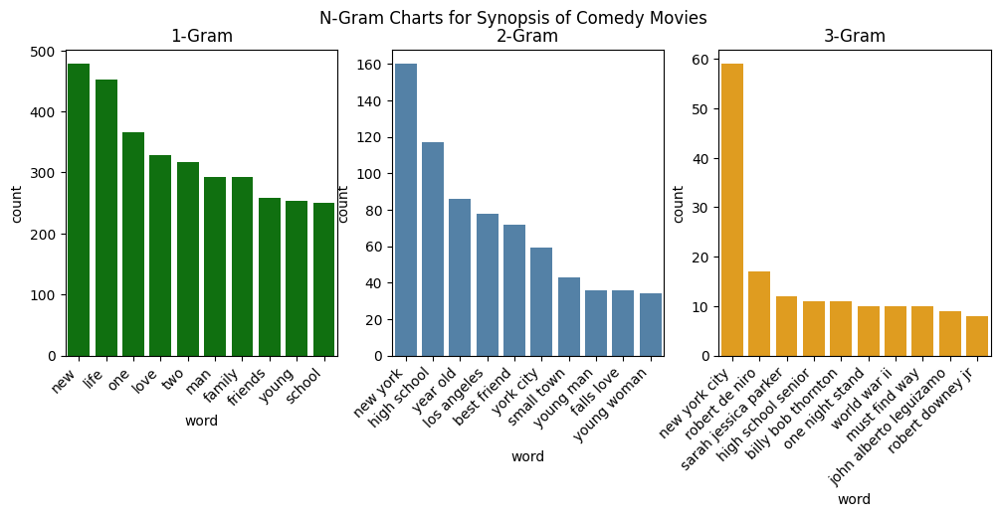

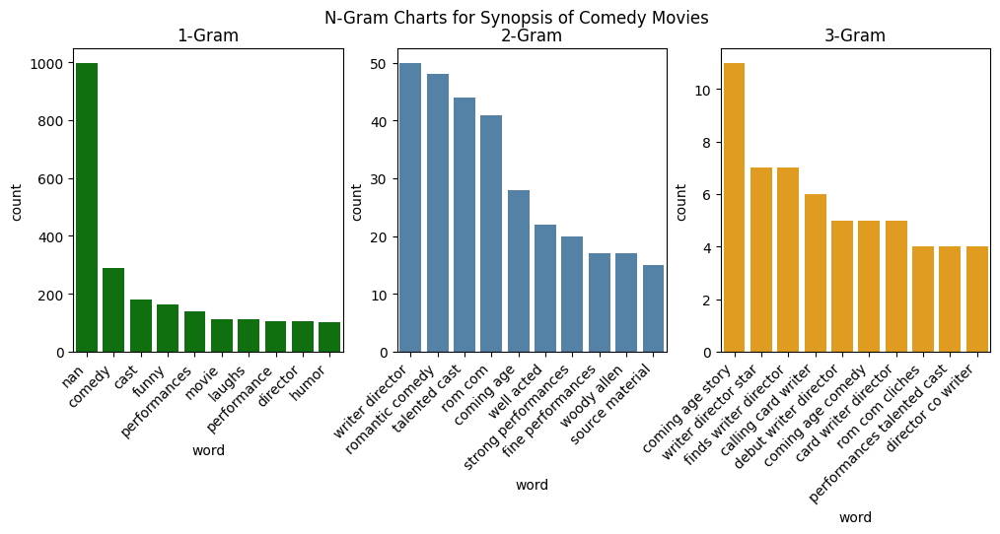

In [20]:
#Argument 1 = Genre
#Argument 2 = cleaned_movie_info or cleaned_critics_consensus
n_gram_charts('Comedy','cleaned_movie_info')
n_gram_charts('Comedy','cleaned_critics_consensus')

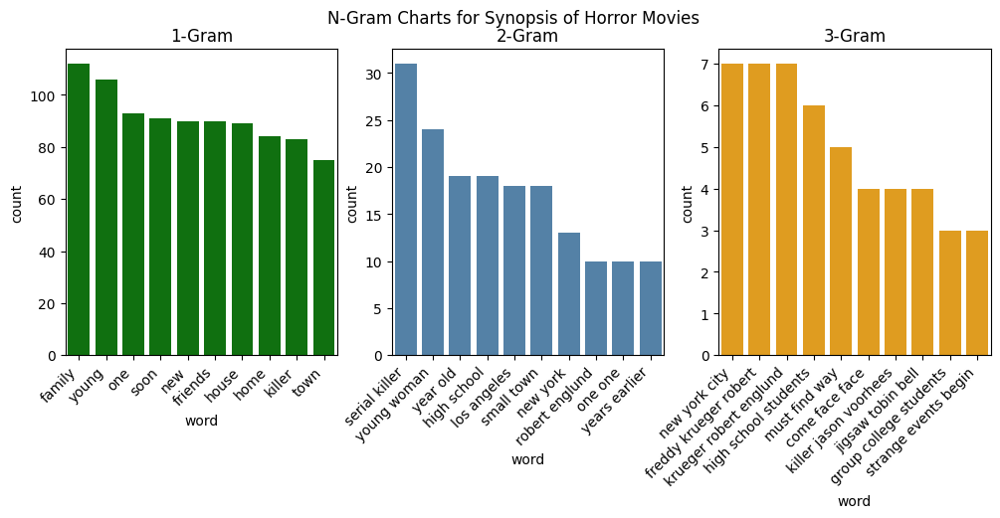

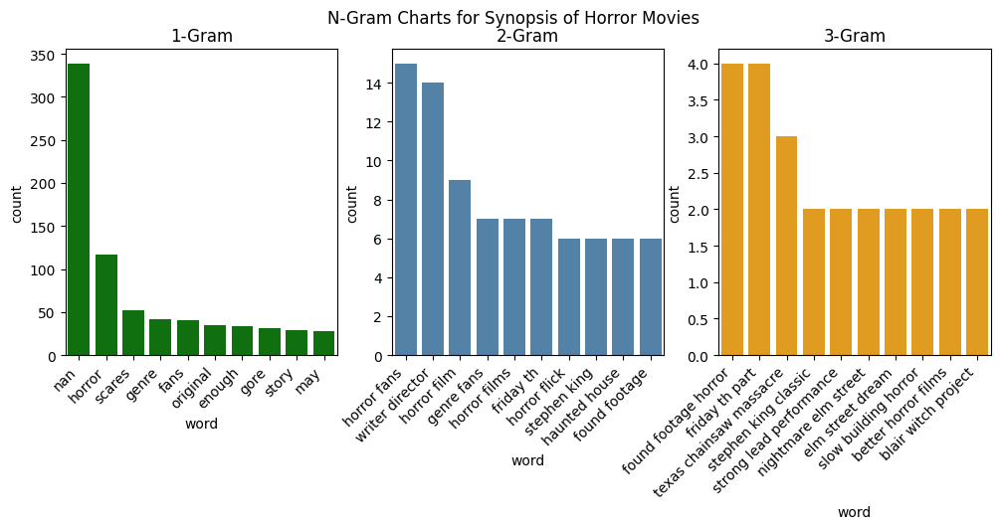

In [21]:
n_gram_charts('Horror','cleaned_movie_info')
n_gram_charts('Horror','cleaned_critics_consensus')

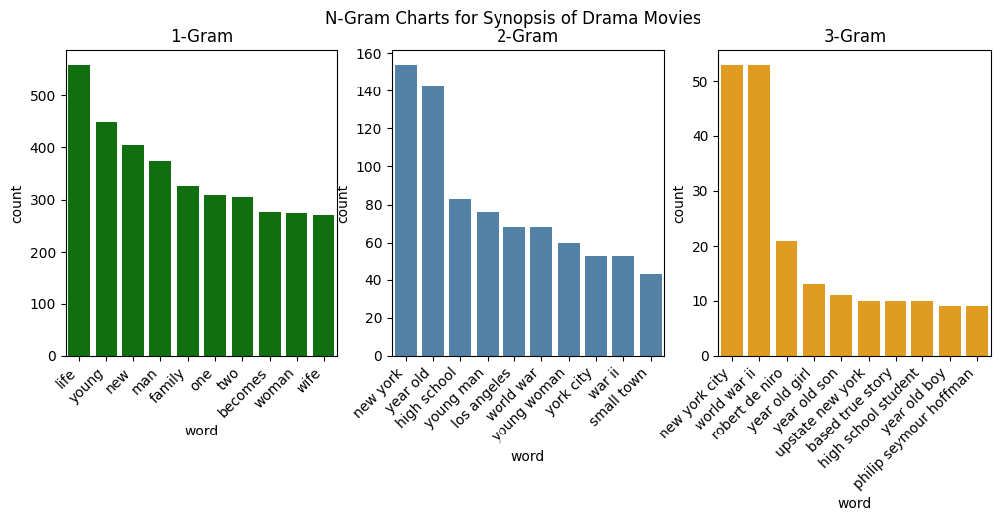

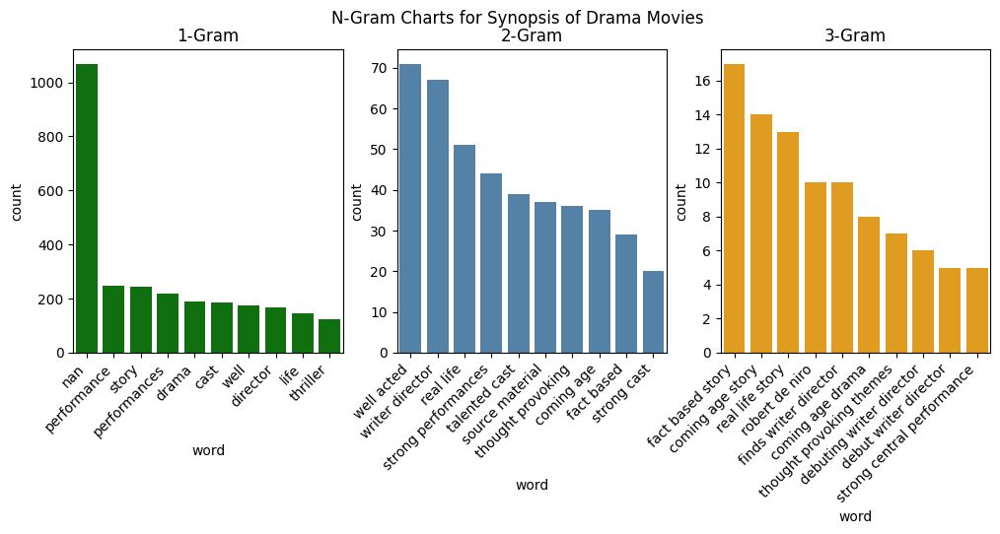

In [22]:
n_gram_charts('Drama','cleaned_movie_info')
n_gram_charts('Drama','cleaned_critics_consensus')

## Part 3: NMF Topic Modeling by Genre over Time

In [23]:
from sklearn.decomposition import NMF

#Define function to create a word cloud visualization of topic modelling results
def topic_model_pipeline(genre,title,beg_year,end_year):
    subset = df[
        (df[f'{genre}']==1) & 
        (df['og_year']>=beg_year) & 
        (df['og_year']<=end_year)]

    #Identify topics with Non-Negative Matrix Factorization method
    vectorizer = TfidfVectorizer(max_df=0.95,min_df=2,stop_words='english')
    dtm = vectorizer.fit_transform(subset['cleaned_movie_info'].values.astype('U'))

    nmf_mod = NMF(n_components=5,random_state=42)
    nmf_mod.fit(dtm)

    df_topics = nmf_mod.transform(dtm)
    df_topic_label = {
            0:"Topic 1",
            1:"Topic 2",       
            2:"Topic 3",
            3:"Topic 4"
        }

    #Label text in dataframe as belonging to one of the topics
    subset['topic_num'] = df_topics.argmax(axis=1)
    subset['topic_label'] = subset['topic_num'].map(df_topic_label)

    topic_count = subset.groupby(['topic_label']).size().reset_index(name='counts')
    topic_count = topic_count.sort_values(by='counts',ascending=False).reset_index()
    
    topic1 = topic_count['topic_label'][0]
    topic2 = topic_count['topic_label'][1]
    topic3 = topic_count['topic_label'][2]
    topic4 = topic_count['topic_label'][3]


    wc_df1 = subset[subset['topic_label']==topic1]
    wc_df2 = subset[subset['topic_label']==topic2]
    wc_df3 = subset[subset['topic_label']==topic3]
    wc_df4 = subset[subset['topic_label']==topic4]

    #Let's look at top topic represented in the word cloud
    wc_df_topic1 = wc_df1['cleaned_movie_info']
    wc_df_topic2 = wc_df2['cleaned_movie_info']
    wc_df_topic3 = wc_df3['cleaned_movie_info']
    wc_df_topic4 = wc_df4['cleaned_movie_info']


    text1 = ' '.join(wc_df_topic1)
    text2 = ' '.join(wc_df_topic2)
    text3 = ' '.join(wc_df_topic3)
    text4 = ' '.join(wc_df_topic4)


    # Create and generate a word cloud image:
    wordcloud1 = WordCloud().generate(text1)
    wordcloud2 = WordCloud().generate(text2)
    wordcloud3 = WordCloud().generate(text3)
    wordcloud4 = WordCloud().generate(text4)
    
    f = plt.figure()
    f.set_figwidth(24)
    f.set_figheight(12)

    #Plot 1:
    plt.subplot(2, 2, 1)
    plt.imshow(wordcloud1, interpolation='bilinear')
    plt.title("Topic 1",fontsize=16)
    plt.axis("off")

    #Plot 2:
    plt.subplot(2, 2, 2)
    plt.imshow(wordcloud2, interpolation='bilinear')
    plt.title("Topic 2",fontsize=16)
    plt.axis("off")
    
    #Plot 3:
    plt.subplot(2, 2, 3)
    plt.imshow(wordcloud3, interpolation='bilinear')
    plt.title("Topic 3",fontsize=16)
    plt.axis("off")
    
    #Plot 4:
    plt.subplot(2, 2, 4)
    plt.imshow(wordcloud4, interpolation='bilinear')
    plt.title("Topic 4",fontsize=16)
    plt.axis("off")
    
    
    plt.suptitle(f"{title}",fontsize=20)
    plt.show();

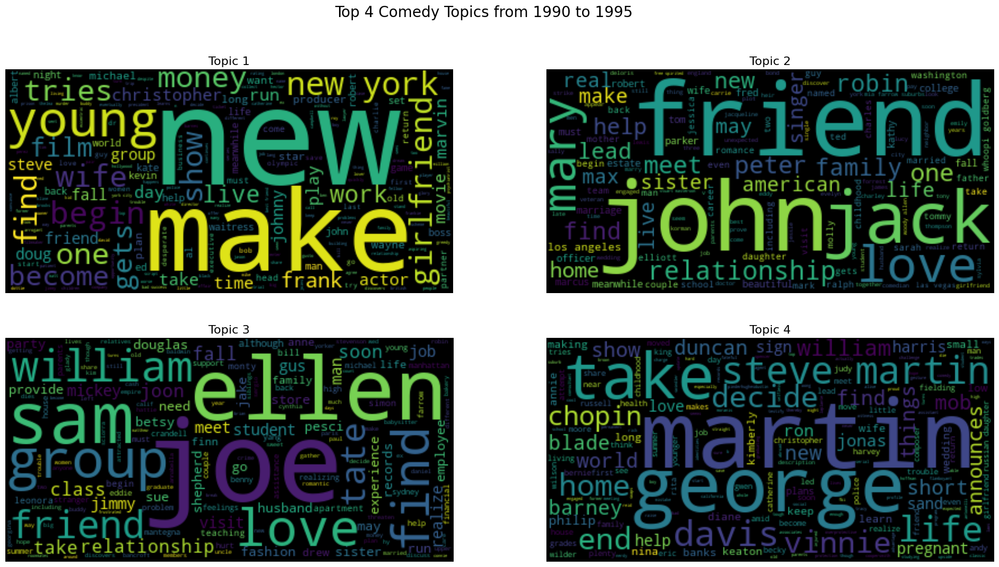

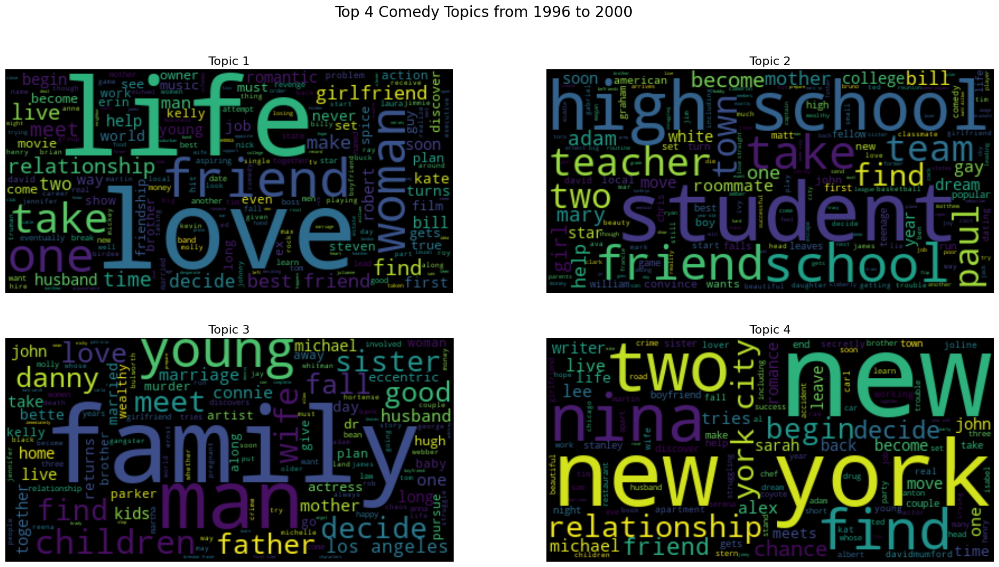

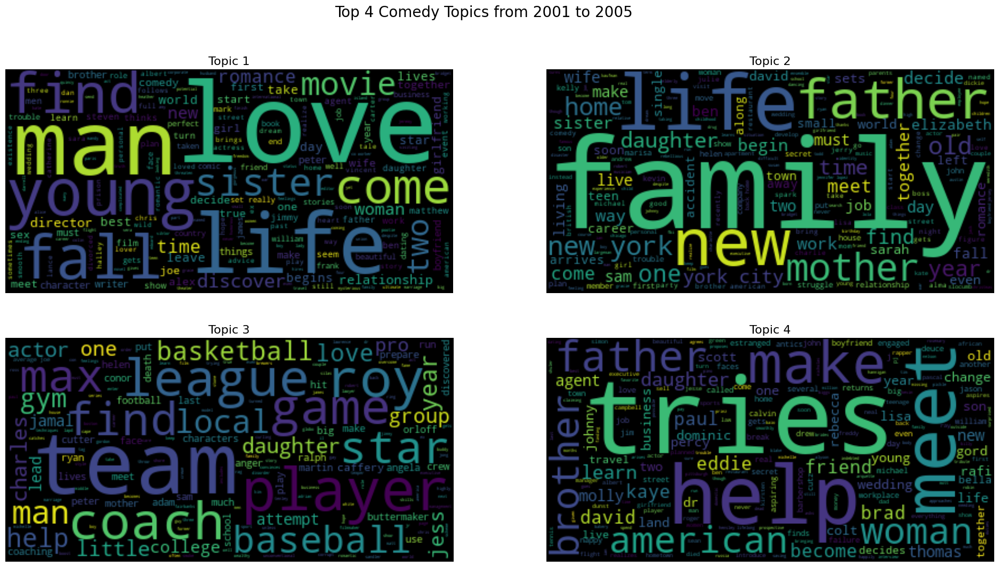

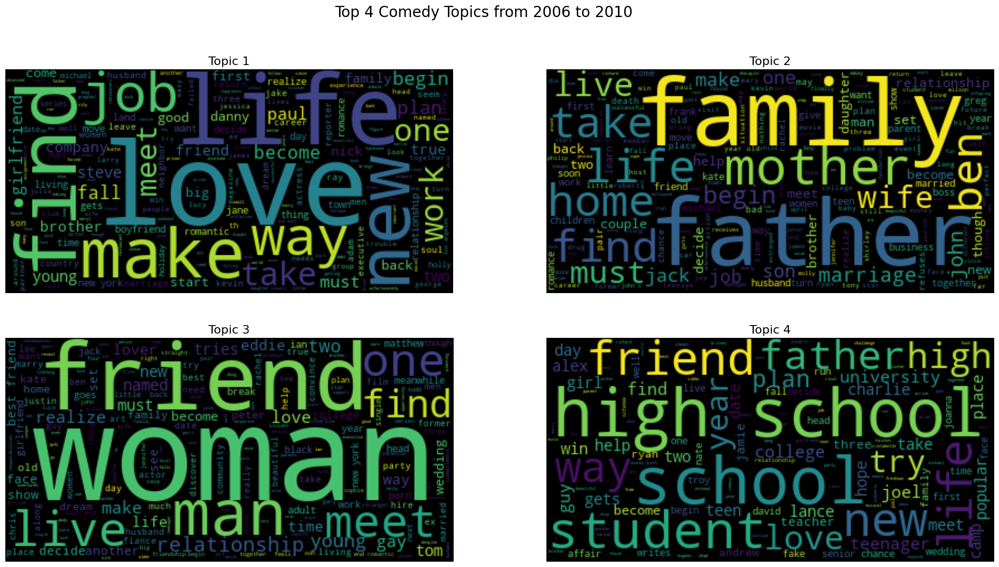

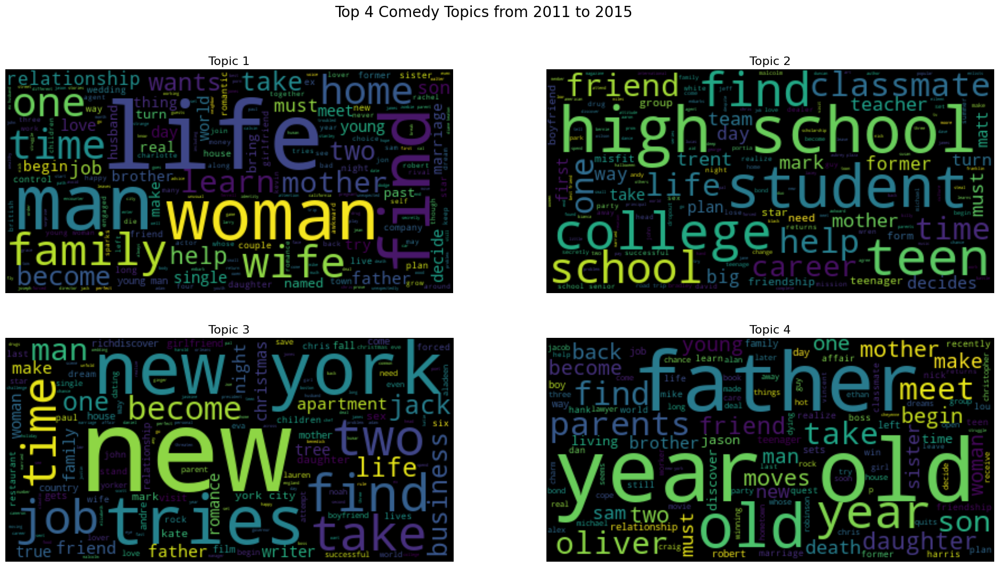

In [24]:
import warnings
warnings.filterwarnings('ignore')

topic_model_pipeline('Comedy','Top 4 Comedy Topics from 1990 to 1995',1990,1995)
topic_model_pipeline('Comedy','Top 4 Comedy Topics from 1996 to 2000',1996,2000)
topic_model_pipeline('Comedy','Top 4 Comedy Topics from 2001 to 2005',2001,2005)
topic_model_pipeline('Comedy','Top 4 Comedy Topics from 2006 to 2010',2006,2010)
topic_model_pipeline('Comedy','Top 4 Comedy Topics from 2011 to 2015',2011,2015)

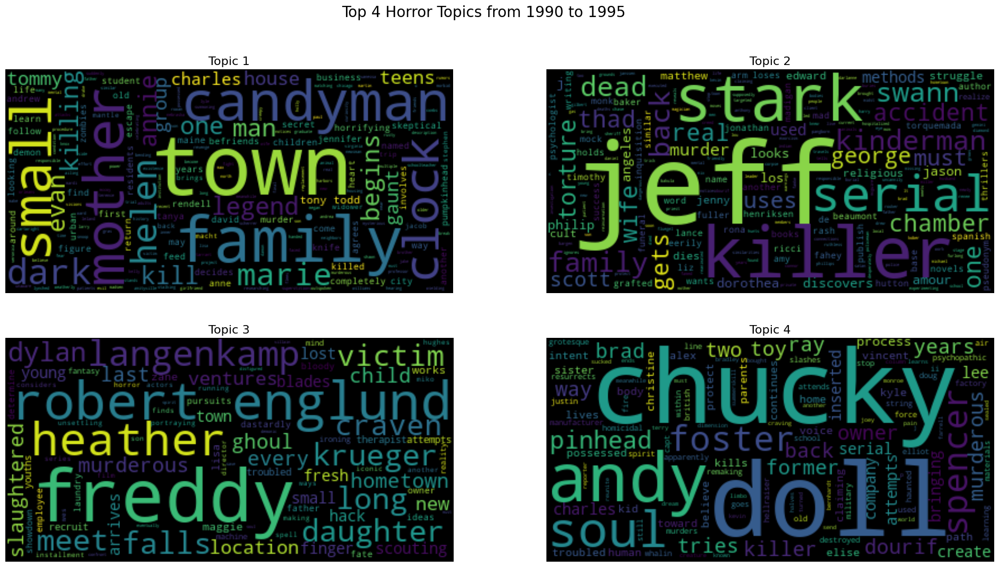

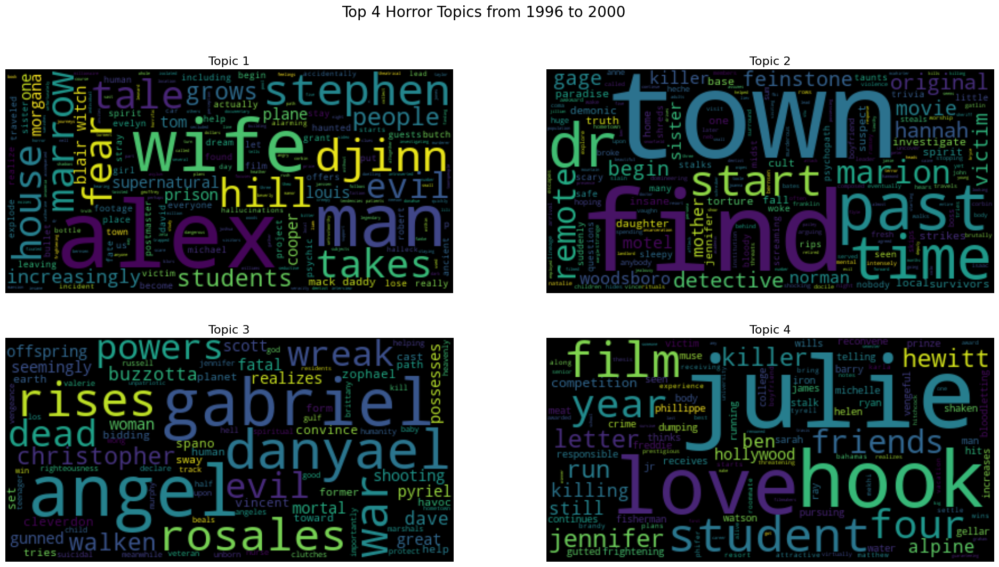

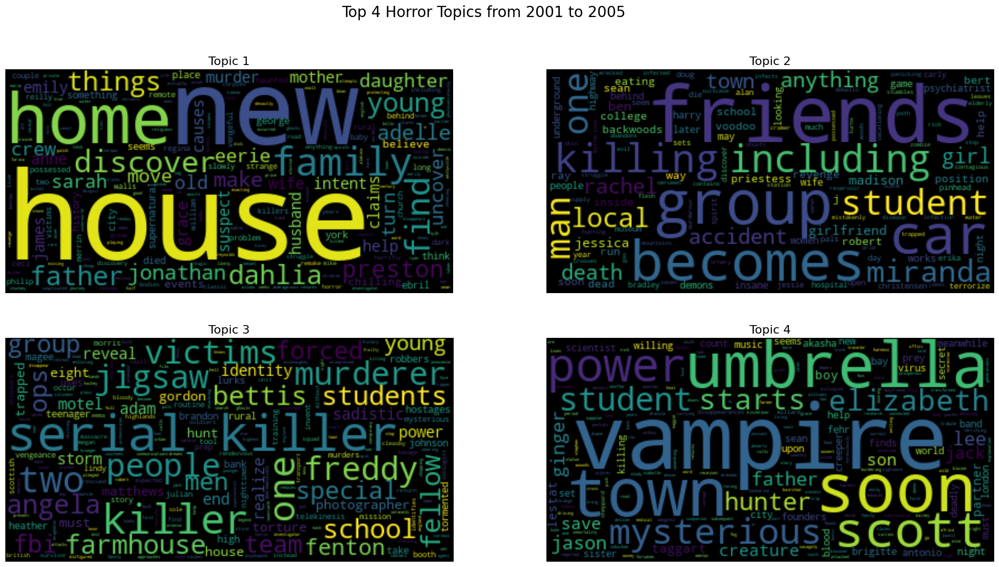

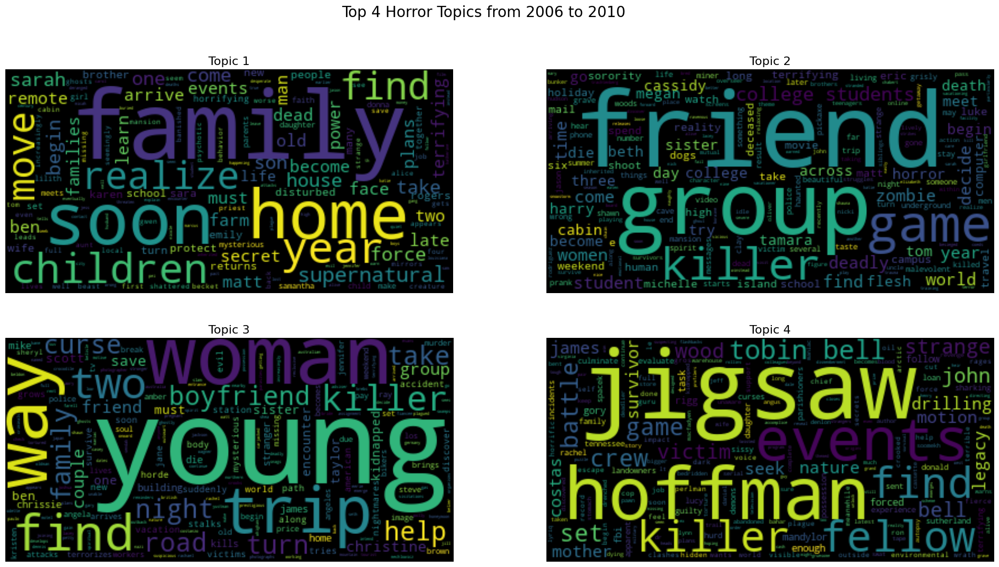

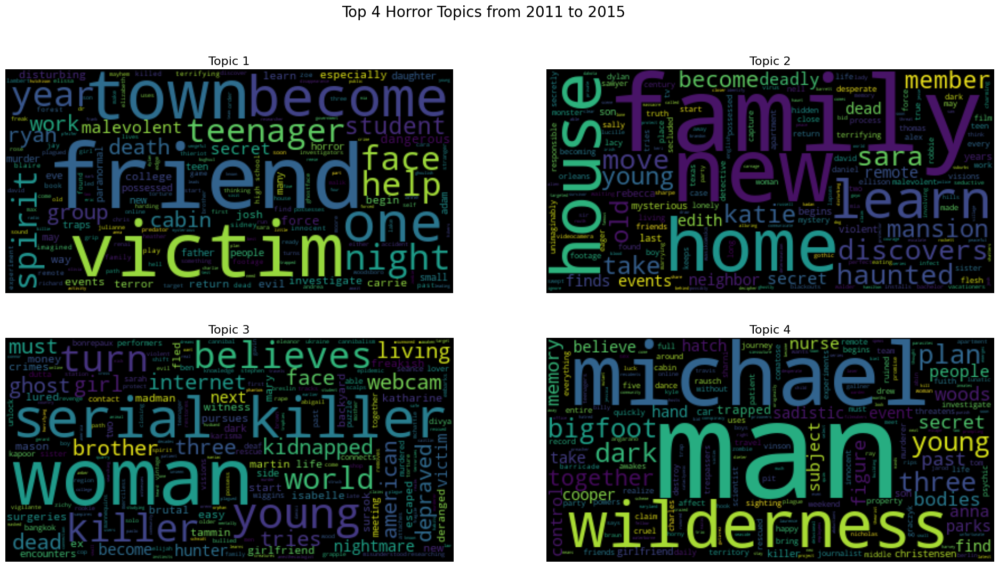

In [25]:
topic_model_pipeline('Horror','Top 4 Horror Topics from 1990 to 1995',1990,1995)
topic_model_pipeline('Horror','Top 4 Horror Topics from 1996 to 2000',1996,2000)
topic_model_pipeline('Horror','Top 4 Horror Topics from 2001 to 2005',2001,2005)
topic_model_pipeline('Horror','Top 4 Horror Topics from 2006 to 2010',2006,2010)
topic_model_pipeline('Horror','Top 4 Horror Topics from 2011 to 2015',2011,2015)

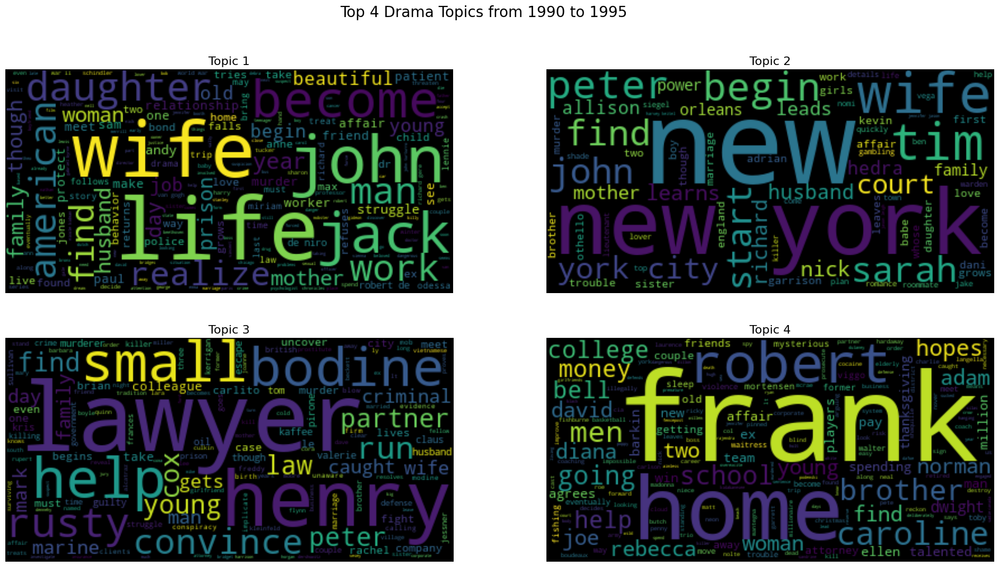

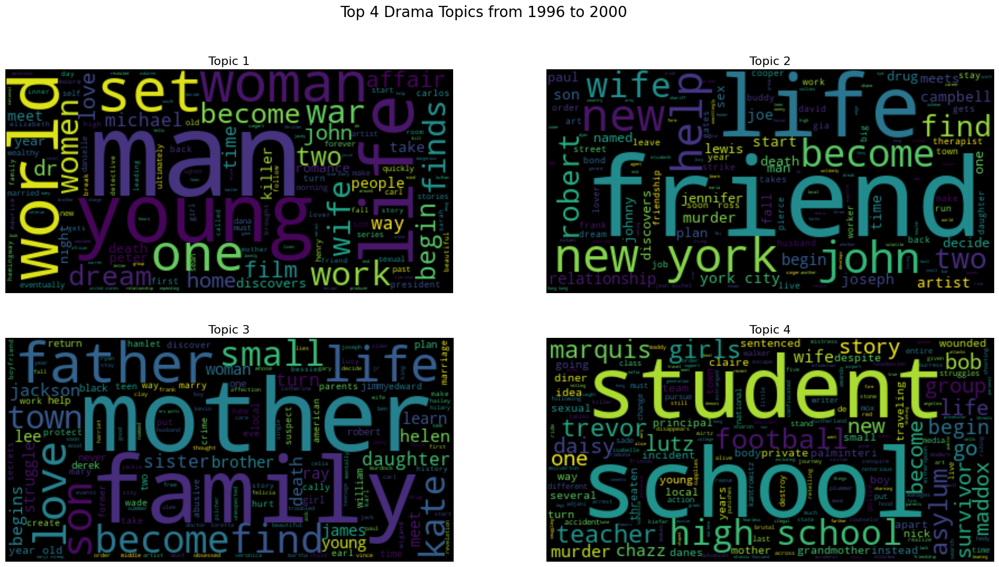

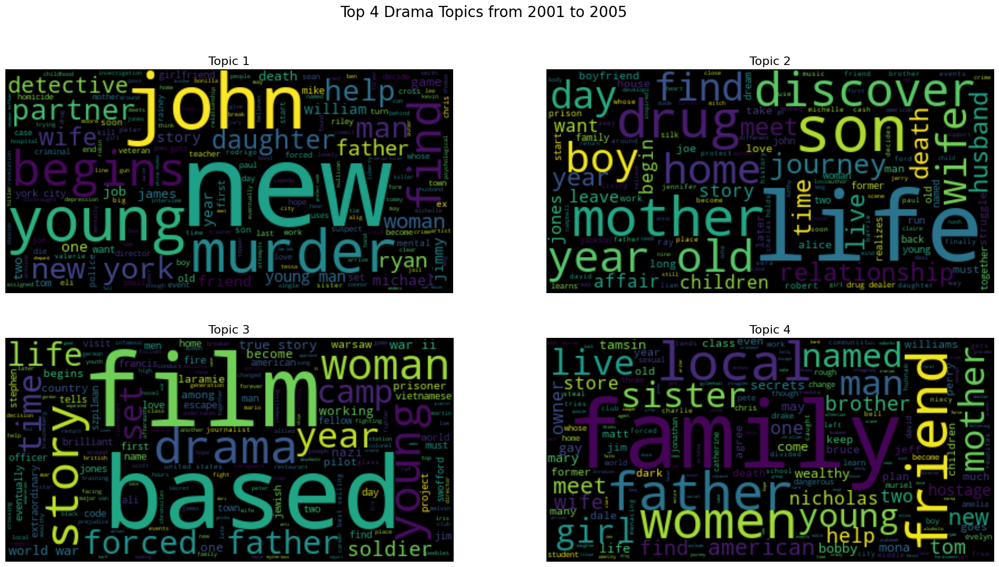

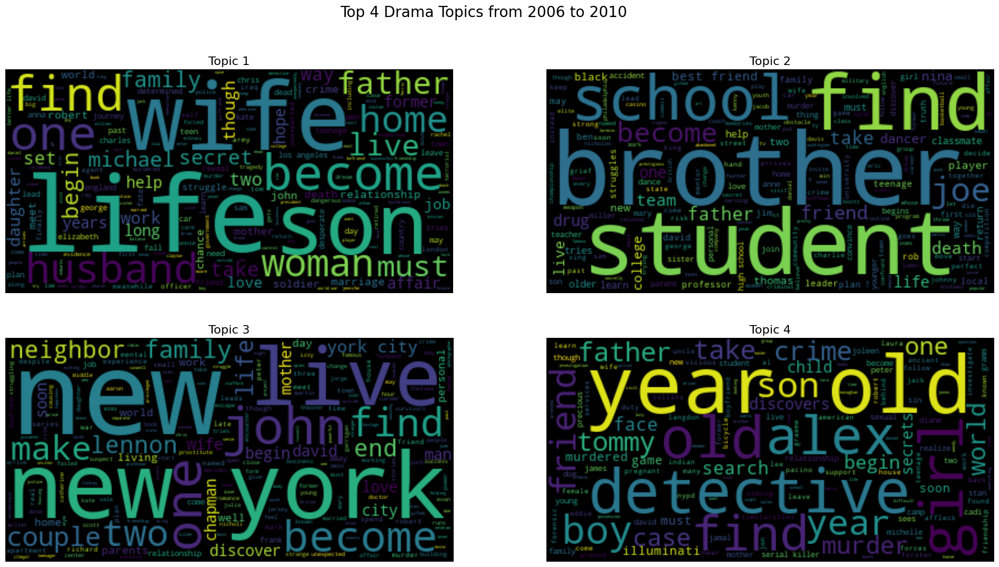

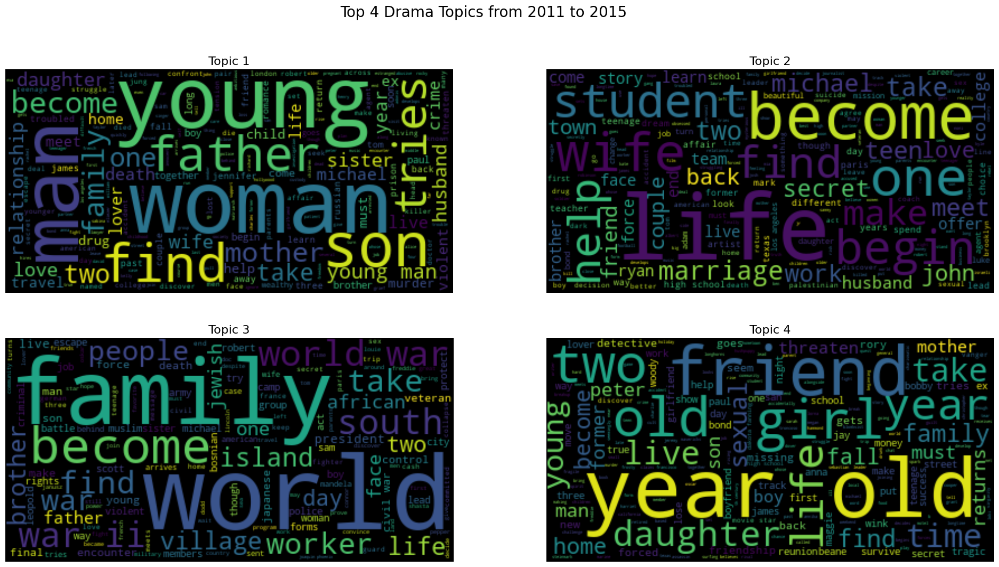

In [26]:
topic_model_pipeline('Drama','Top 4 Drama Topics from 1990 to 1995',1990,1995)
topic_model_pipeline('Drama','Top 4 Drama Topics from 1996 to 2000',1996,2000)
topic_model_pipeline('Drama','Top 4 Drama Topics from 2001 to 2005',2001,2005)
topic_model_pipeline('Drama','Top 4 Drama Topics from 2006 to 2010',2006,2010)
topic_model_pipeline('Drama','Top 4 Drama Topics from 2011 to 2015',2011,2015)

## Part 4: LDA Topic Modeling by Genre and Sentiment

In [27]:
import spacy
#%pip install gensim
import gensim
from gensim.utils import simple_preprocess
from gensim.models import Phrases, phrases, ldamodel, CoherenceModel
import gensim.corpora as corpora
from pprint import pprint
import warnings
warnings.filterwarnings("ignore")
#%pip install pyLDAvis
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis


def lda_pipeline(genre,sentiment_class,choose_num_topics):
    subset = df[
        (df[f'{genre}']==1) & 
        (df['synopsis_sentiment_class']==sentiment_class)
    ]
    #Prepare data
    
    def text_to_tokens (textSentences):
        for sent in textSentences:
            yield(simple_preprocess(str(sent),deacc=True))


    wordsData=subset['cleaned_movie_info'].values.tolist()
    wordsDataList = list(text_to_tokens(wordsData))
    tokens = Phrases(wordsDataList,min_count=5,threshold=100)
    tokensModel = phrases.Phraser(tokens)

    #Building the tokens
    tokens = Phrases(wordsDataList,min_count=5,threshold=100)
    tokensModel = phrases.Phraser(tokens)


    #Build N-Grams
    def make_tokens_model(textSentences):
        return[tokensModel[doc] for doc in textSentences]


    def lemmatizedText(textSentences, allowed_postags=['NOUN','ADJ','VERB','ADV']):
        textSent_Output = []
        for sent in textSentences:
            doc = nlp(" ".join(sent))
            textSent_Output.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
        return textSent_Output

    #For N-Gram
    dataWordsngrams = make_tokens_model(wordsDataList)


    #Initialize spacy "en" model keeping only the tagger component 
    nlp = spacy.load("en_core_web_sm",disable=['parser','ner'])

    #Lemmatize keeping only noun, adj, adv and verbs
    lemmatizedTextData = lemmatizedText(dataWordsngrams, allowed_postags=["NOUN","ADJ","VERB","ADV"])

    #Create dictionary
    dictObject = corpora.Dictionary(lemmatizedTextData)
    #Create corpus
    textData = lemmatizedTextData

    #Term document frequency
    corpusData = [dictObject.doc2bow(text) for text in textData]  

    #Build the model
    n_topics = choose_num_topics
    ldaModel = ldamodel.LdaModel(corpus=corpusData,
                                  id2word = dictObject,
                                  num_topics=n_topics,
                                  random_state=123,
                                  chunksize=100,
                                  passes=10,
                                  alpha=0.01,
                                  eta='auto',
                                  iterations=100,
                                  per_word_topics = True                            
                                  )
    #Calculate coherence
    coherenceModelLda = CoherenceModel(model=ldaModel, texts = lemmatizedTextData,dictionary=dictObject,coherence='c_v')
    coherenceScore = coherenceModelLda.get_coherence()
    print("Coherence Score: ",coherenceScore)

    #Output LDA plots
    pyLDAvis.enable_notebook()
    vis=pyLDAvis.gensim_models.prepare(ldaModel,corpusData,dictObject)
    return vis


#### Comedy Topics

In [28]:
#Argument 1 = genre
#Argument 2 = sentiment (pos or neg)
#Argument 3 = # topics
lda_pipeline('Comedy',1,4)

Coherence Score:  0.32627167243820443


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3      0.236598  0.031648       1        1  47.706482
2      0.022116 -0.027156       2        1  23.254237
1     -0.108032 -0.177354       3        1  16.828495
0     -0.150682  0.172861       4        1  12.210786, topic_info=         Term        Freq       Total Category  logprob  loglift
213  marriage   68.000000   68.000000  Default  30.0000  30.0000
460      meet  172.000000  172.000000  Default  29.0000  29.0000
69     decide  113.000000  113.000000  Default  28.0000  28.0000
109        go  138.000000  138.000000  Default  27.0000  27.0000
32        way  107.000000  107.000000  Default  26.0000  26.0000
..        ...         ...         ...      ...      ...      ...
81       turn   20.005519  116.345557   Topic4  -5.3461   0.3423
77        man   19.397680  181.950287   Topic4  -5.3769  -0.1357
181      take   18.060362  166.989653   Topic4  -5.4483  -0.1214
84      young   17.159834  146.788950   Topic4  -5.4995  -0.0436
593    parent   13.461636   48.016664   Topic4  -5.7422   0.8311

[232 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
1869      4  0.913368  abandon
2964      3  0.981206  ability
1922      2  0.889181   accept
1922      4  0.077320   accept
141       3  0.937873      act
...     ...       ...      ...
102       1  0.993482     year
84        1  0.722125    young
84        2  0.081750    young
84        3  0.081750    young
84        4  0.115813    young

[279 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 3, 2, 1])

In [45]:
lda_pipeline('Comedy',0,7)

Coherence Score:  0.4068329008719906


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.235054 -0.019389       1        1  29.651820
1     -0.142413 -0.023752       2        1  18.373774
4     -0.018023 -0.017614       3        1  12.564139
2      0.034040  0.252293       4        1  12.295127
6      0.088550 -0.155986       5        1   9.321615
5      0.156204  0.028249       6        1   9.103851
3      0.116696 -0.063801       7        1   8.689674, topic_info=       Term        Freq       Total Category  logprob  loglift
558  mother   85.000000   85.000000  Default  30.0000  30.0000
720   young   55.000000   55.000000  Default  29.0000  29.0000
299   child   68.000000   68.000000  Default  28.0000  28.0000
5      life  130.000000  130.000000  Default  27.0000  27.0000
218    boss   28.000000   28.000000  Default  26.0000  26.0000
..      ...         ...         ...      ...      ...      ...
17    thing   12.539035   27.282208   Topic7  -4.9273   1.6656
46     find   18.060604  145.543424   Topic7  -4.5624   0.3563
407   steal   11.555964   27.490237   Topic7  -5.0089   1.5764
309   learn   10.284017   36.545785   Topic7  -5.1256   1.1751
603    keep    9.492954   22.342810   Topic7  -5.2056   1.5871

[358 rows x 6 columns], token_table=      Topic      Freq          Term
term                               
623       3  0.994260      accident
69        2  0.965255  accidentally
865       1  0.978969         actor
3178      7  0.978341       actress
236       1  0.973144         agree
...     ...       ...           ...
4486      5  0.909793       writing
768       2  0.956287         wrong
364       1  0.812578          year
364       2  0.179043          year
720       2  0.986553         young

[471 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 2, 5, 3, 7, 6, 4])

#### Horror Topics

In [46]:
lda_pipeline('Horror',1,5)

Coherence Score:  0.39755938001744884


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4      0.133397 -0.055041       1        1  28.913196
3      0.058776  0.012903       2        1  20.740339
2     -0.133215 -0.103563       3        1  18.367891
1     -0.009471 -0.000047       4        1  16.541629
0     -0.049487  0.145748       5        1  15.436945, topic_info=        Term       Freq      Total Category  logprob  loglift
233   become  16.000000  16.000000  Default  30.0000  30.0000
111   friend  25.000000  25.000000  Default  29.0000  29.0000
68     force  12.000000  12.000000  Default  28.0000  28.0000
471  quickly   7.000000   7.000000  Default  27.0000  27.0000
178      way   6.000000   6.000000  Default  26.0000  26.0000
..       ...        ...        ...      ...      ...      ...
465     teen   1.913861   5.894082   Topic5  -5.2619   0.7436
337      try   2.201743  10.890061   Topic5  -5.1218   0.2698
579  survive   1.597371   3.094037   Topic5  -5.4427   1.2073
329     make   2.018568   9.279812   Topic5  -5.2087   0.3430
43    family   1.980875  10.809285   Topic5  -5.2275   0.1715

[301 rows x 6 columns], token_table=      Topic      Freq        Term
term                             
179       1  0.258690        able
179       4  0.776069        able
992       4  0.536421  admiration
1058      3  0.596690      agency
128       3  0.975039       agree
...     ...       ...         ...
85        1  0.352558       young
85        2  0.088139       young
85        3  0.352558       young
85        4  0.264418       young
409       2  0.802020      zombie

[388 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[5, 4, 3, 2, 1])

In [52]:
lda_pipeline('Horror',0,7)

Coherence Score:  0.36916563990046836


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3      0.211876  0.051418       1        1  32.031043
2      0.097545  0.127763       2        1  18.069170
4     -0.014862 -0.185843       3        1  13.719015
1      0.063754 -0.129083       4        1  12.455401
0     -0.138792  0.098559       5        1   9.248346
6     -0.075754  0.016701       6        1   7.612919
5     -0.143766  0.020485       7        1   6.864106, topic_info=         Term       Freq      Total Category  logprob  loglift
69      woman  60.000000  60.000000  Default  30.0000  30.0000
149      lead  24.000000  24.000000  Default  29.0000  29.0000
54       grow  21.000000  21.000000  Default  28.0000  28.0000
158    friend  57.000000  57.000000  Default  27.0000  27.0000
811      send  16.000000  16.000000  Default  26.0000  26.0000
..        ...        ...        ...      ...      ...      ...
216    mother   5.363059  26.522144   Topic7  -4.9690   1.0804
228     thing   4.121109  10.055439   Topic7  -5.2324   1.7869
661  together   3.700420  17.615305   Topic7  -5.3401   1.1185
142     event   3.805010  29.233830   Topic7  -5.3122   0.6399
223   strange   3.556355  26.231382   Topic7  -5.3798   0.6806

[383 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
473       1  0.987095    abandon
70        1  0.850794   accident
70        6  0.113439   accident
421       4  0.936431  accompany
2420      6  0.794463      actor
...     ...       ...        ...
348       1  0.593576      young
348       2  0.092334      young
348       3  0.145096      young
348       4  0.158287      young
348       7  0.013191      young

[535 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 3, 5, 2, 1, 7, 6])

#### Drama Topics

In [53]:
lda_pipeline('Drama',1,5)

Coherence Score:  0.3490862416574621


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.202038  0.062881       1        1  34.412135
2     -0.010459  0.079314       2        1  21.288626
1     -0.082458 -0.151627       3        1  19.004651
4      0.146195  0.145082       4        1  15.718476
3      0.148761 -0.135650       5        1   9.576111, topic_info=         Term        Freq       Total Category  logprob  loglift
48      young  162.000000  162.000000  Default  30.0000  30.0000
931       way   60.000000   60.000000  Default  29.0000  29.0000
316  marriage   57.000000   57.000000  Default  28.0000  28.0000
35        man  156.000000  156.000000  Default  27.0000  27.0000
775     leave   41.000000   41.000000  Default  26.0000  26.0000
..        ...         ...         ...      ...      ...      ...
705      look    9.516094   24.525903   Topic5  -5.4337   1.3992
102      must   10.191889   56.577748   Topic5  -5.3651   0.6319
26       find   11.473320  144.139540   Topic5  -5.2467  -0.1849
314   husband    8.725157   28.002572   Topic5  -5.5205   1.1798
114      life    9.124217  223.153887   Topic5  -5.4758  -0.8510

[283 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
1840      4  0.901956     addict
916       3  0.952005    already
18        1  0.954234  ambitious
716       1  0.974320      apart
2211      5  0.951414    arrange
...     ...       ...        ...
181       2  0.967526      write
1046      1  0.959400     writer
669       4  0.980030   year_old
48        1  0.805442      young
48        3  0.190601      young

[357 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 3, 2, 5, 4])

In [55]:
lda_pipeline('Drama',0,4)

Coherence Score:  0.3665190796340524


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2     -0.138483 -0.070895       1        1  35.500828
0     -0.158066  0.057982       2        1  34.918700
3      0.156391 -0.151686       3        1  14.961930
1      0.140157  0.164599       4        1  14.618542, topic_info=       Term        Freq       Total Category  logprob  loglift
140    life  263.000000  263.000000  Default  30.0000  30.0000
342   world   77.000000   77.000000  Default  29.0000  29.0000
794   force   98.000000   98.000000  Default  28.0000  28.0000
332    know   66.000000   66.000000  Default  27.0000  27.0000
297    lose   65.000000   65.000000  Default  26.0000  26.0000
..      ...         ...         ...      ...      ...      ...
17      man   21.478147  183.025942   Topic4  -5.3104  -0.2197
548   death   17.423296   79.428688   Topic4  -5.5196   0.4058
981     way   15.908140   54.831704   Topic4  -5.6106   0.6854
44   become   16.786209  180.648791   Topic4  -5.5568  -0.4531
430  murder   16.280441  126.116808   Topic4  -5.5874  -0.1244

[242 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
2123      1  0.992225   abandon
174       3  0.977957  accident
607       4  0.931150     adult
301       2  0.095315       age
301       4  0.857834       age
...     ...       ...       ...
207       3  0.120506      year
452       4  0.954095  year_old
173       1  0.484119     young
173       2  0.478617     young
173       3  0.033008     young

[300 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 1, 4, 2])